# **MonteCarlo exercise** - Cayetano Soneira

Choose one of the following examples and code it in R. Upload the code accompanied by a brief report
(no more than 4 pages) with a description of the method and some results.
1. Metropolis for hard spheres. Use this algorithm to get random numbers for pairs of non-
overlapping spheres or disks of radius R in a square box of side L, uniformly distributed. Study
the convergence of quantities such that the distance between spheres, or the closest distance of
any sphere to a wall. Check for the cases of 2 or three disks. Compare the cases when L is large
compared to R with the case when the spheres just fit into the box.
2. Simplified nuclear reactor. Simulate a simple version of a nuclear reactor in which the mean
free path is constant (for example = 1). The mean number of neutrons in each fission is also
fixed (for example to 3). Study as a function of the size of the container if the process grows
exponentially or stays under control. Assume exponential law for the distance before an
interaction and Poisson law for the number of neutrons
3. Free exercise. If you have any other possible example propose it to me and I will confirm if it
matches the expected difficulty and contents

The simulation of an experiment could be considered as a mixture model: the variable from which we calculate probabilities is at the same time a random variable from another distribution. The simulation of an experiment is then a chain of processes, each one with a probability. For example, it could be:
- Underlying physics. *Model for neutrino production in a supernova.*
- Evolution. *Moving through space.*
- Interaction. *Chance of interacting with matter.*
- Detection. *Chance of detection in our observatory.*

**Toy model:** simplified simulation consisting in:
- Generate values and shake them.
- Add efficiency effect (random chance of detection).
- Add background.
- Calculate derived quantities.

**Example: decay of a particle into two particles $A$ and $B$, initial mass $M$ and final momenta $p_{A},\ p_{B}$.**
1. Generate $N$ ideal pairs of $p_{A},\ p_{B}$
2. Efficiency chance to loose $A$ or $B$, $$\varepsilon=\frac{number\ detected}{total\ produced}.$$ We generate a random number to see if detected: else we remove $A$ or $B$.
3. If detected, wht is the true energy: $$p_{A}+\sigma\cdot N(0,1).$$

---
**Transport processes:** processes where a magnitude propagates in time and space.

---

**Nuclear fission:**
1. **Physical model:** A neutron is produced with a given E and direction.
2. **Propagation I:** Interaction given an average path length, $\lambda(E)$, that happens at $l\approx e^{-\frac{x}{\lambda}}$.
3. **Propagation II:** Check if inside: if yes, simulate the reaction; else (no), we are done with that neutron.
4. **Interaction**: Simulate fission:
    - Physics model for fission
    - number of neutrons generated
    - Energy of neutrons
    - Direction of neutrons
    - **Go back to step 2**

### Nuclear fission

**Simplified nuclear reactor.** Simulate a simple version of a nuclear reactor in which the mean free path is constant (for example = 1). The mean number of neutrons in each fission is also fixed (for example to 3). Study as a function of the size of the container if the process grows exponentially or stays under control. Assume exponential law for the distance before an interaction and Poisson law for the number of neutrons.

Total neutrons 1 
Lost neutrons: 1 
Thermally absorbed neutrons: 0 


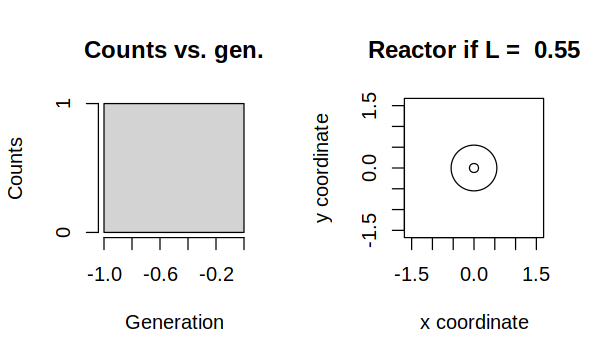

Total neutrons 1 
Lost neutrons: 1 
Thermally absorbed neutrons: 0 


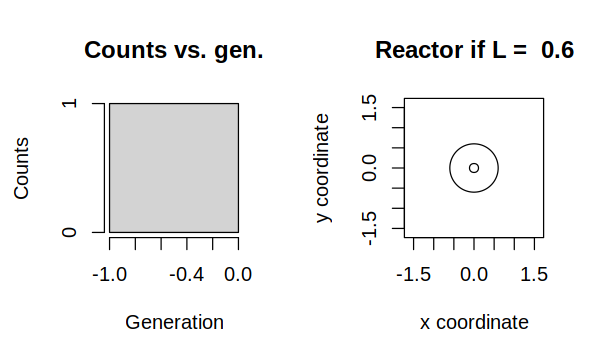

Total neutrons 6375 
Lost neutrons: 2875 
Thermally absorbed neutrons: 93 


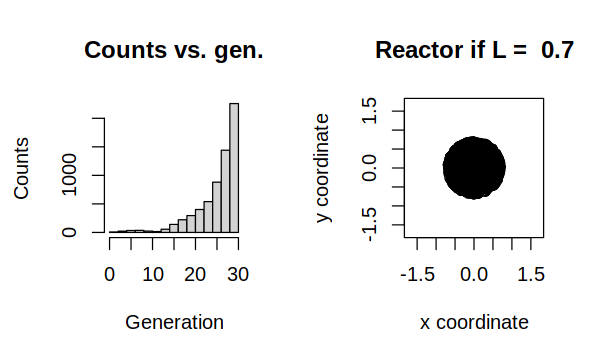

Total neutrons 8062 
Lost neutrons: 2332 
Thermally absorbed neutrons: 127 


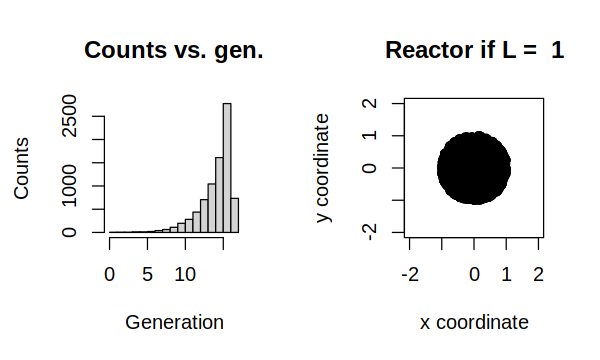

Total neutrons 14616 
Lost neutrons: 143 
Thermally absorbed neutrons: 248 


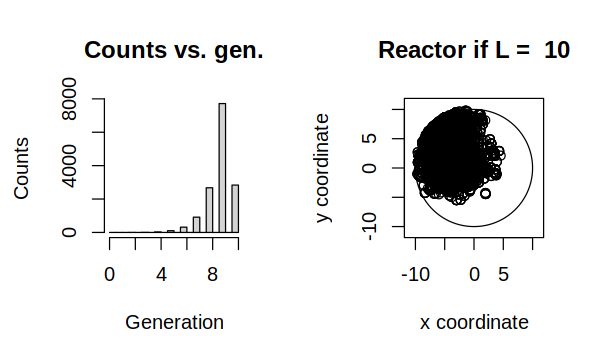

Total neutrons 14959 
Lost neutrons: 0 
Thermally absorbed neutrons: 258 


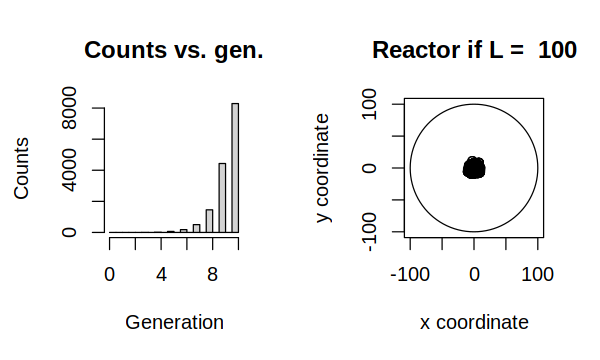

In [173]:
library("plotrix")

# 1. We get some initial neutrons with some position and momentum
# (x,y,px,py)
table <- rbind(c(0,0,-0.5,0.5,0))

# 1.1 We set the size of the container, in this case a circular reactor with radius L
#Ls <- seq(from = 0.5, to = 0.6, by = 0.01)
Ls <- c(0.55,0.6,0.7,1,10,100)
# 1.2. The mean free path
long <- 1
# 1.3. The mean of the poisson
lambda <- 3
# 1.4 The number of iterations
Niter <- 5000

for (L in Ls){
        # 2. We start the chain reaction
        total_neutrons <- c()
        lost_neutrons <- 0
        thermally_absorbed <- 0
        
        table <- rbind(c(0,0,-0.5,0.5,0))
        
        for (i in 1:Niter){
            
            if ( i > length(table[,1]) ){
                #cat("Reaction dissipated at ",i, " iterations\n")
                break
                }

            x <- table[i,1]
            y <- table[i,2]
            px <- table[i,3]
            py <- table[i,4]
            p <- sqrt(px**2 + py**2)
            gen <- table[i,5]

            # 3. We get the position of the interaction:
            alpha <- atan2(py,px)
            l <- rexp(1, rate=1/long)
            newx <- x + l*cos(alpha)
            newy <- y + l*sin(alpha)

            # 4. We see if this neutron is inside of the reactor:
            if (sqrt(newx**2 + newy**2) > L){
                lost_neutrons <- lost_neutrons + 1
                next
            }

            # 5. Once we know it is inside, we calculate the number of neutrons generated in the fission:
            neutrons <- rpois(1, lambda)

            if (neutrons == 0){
                thermally_absorbed <- thermally_absorbed + 1
                next
                }

            for (j in 1:neutrons){
                beta <- runif(1,0,2*pi)
                table <- rbind(table,c(newx,newy,p*cos(beta),p*sin(beta),gen + 1))
                }
        }
    
            options(repr.plot.width=5,repr.plot.height=3)
            par(mfrow=c(1,2))

            hist(table[,5],main = paste("Counts vs. gen."),xlab = paste("Generation"), ylab = "Counts")

            par(pty="s")
            plot(table[,1],table[,2],xlim = c(-L-1, L+1),ylim = c(-L-1, L+1),xlab = paste("x coordinate"), ylab = "y coordinate")
            title(main = paste("Reactor if L = ", L))
            draw.circle(0, 0, L)

            cat("Total neutrons",length(table[,1]),"\n")
            cat("Lost neutrons:",lost_neutrons,"\n")
            cat("Thermally absorbed neutrons:",thermally_absorbed,"\n")           
}

## Getting a random position for hard-spheres in a square box.

In [180]:
metroBox <- function(a,N,Niter,L,R){
    
    mea <- c()
    
    # 1. Generate a sample of random walkers
    
    r <- cbind(runif(N,R,(L-R)/2),runif(N,R,(L-R)/2),runif(N,(L-R)/2,(L-R)),runif(N,(L-R)/2,L-R))
    
    for (i in 1:Niter){
        # 2. Calculate the random walk
        delta <- cbind(runif(N,-a,a),runif(N,-a,a),runif(N,-a,a),runif(N,-a,a))
        
        # 3 & 4. Evaluate q and accept/reject rn with prob q
        q <- rep(1,N)
        t <- runif(N,0,1)
        
        rini <- r
        r <- r + delta
        
        q <- ifelse( sqrt( (r[,1]-r[,3])**2 + (r[,2]-r[,4]) **2) < 2*rep(R,N), rep(0,N), q)
        
        q <- ifelse( r[,1] < R, rep(0,N), q)
        q <- ifelse( r[,1] > L-R, rep(0,N), q)
        
        q <- ifelse( r[,2] < R, rep(0,N), q)
        q <- ifelse( r[,2] > L-R, rep(0,N), q)
        
        q <- ifelse( r[,3] < R, rep(0,N), q)
        q <- ifelse( r[,3] > L-R, rep(0,N), q)
        
        q <- ifelse( r[,4] < R, rep(0,N), q)
        q <- ifelse( r[,4] >L-R, rep(0,N), q)
        
        # r <- ifelse(cbind(t,t,t,t)<cbind(q,q,q,q),r,rini)
        r <- ifelse(cbind(t,t,t,t)<cbind(q,q,q,q),r,rini)
        
        mea <- c(mea, mean(sqrt( (r[,1]-r[,3])**2 + (r[,2]-r[,4]) **2)))
        
        # 5. Keep iterating
        }
    
    plot(mea,pch=20)
    cat("Mean of the mean distance: ",mean(mea),"\n")
    cat("Standard deviation of the mean distance: ",sd(mea))
    return(r)
}

Mean of the mean distance:  4.725759 
Standard deviation of the mean distance:  0.2252543

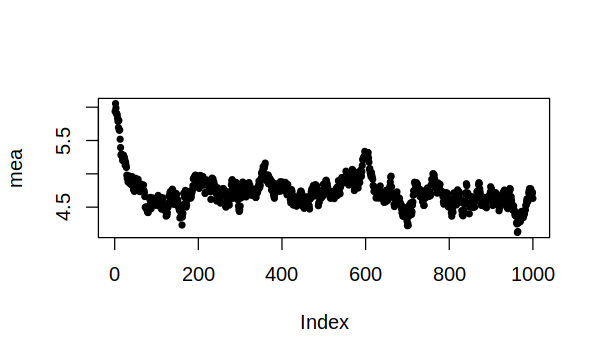

In [184]:
y <- metroBox(1,100,1000,10,1)

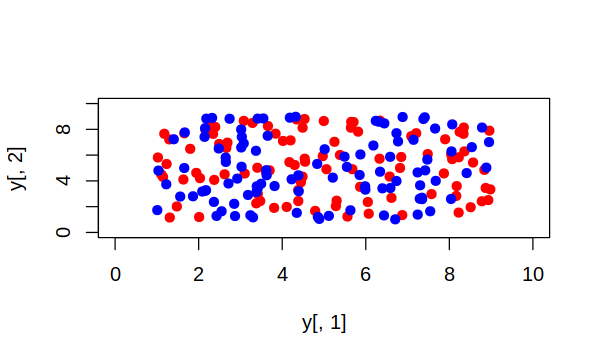

In [185]:
plot(y[,1],y[,2],col="red",xlim = c(0, 10),ylim = c(0, 10),pch=19)
points(y[,3],y[,4],col= "blue",pch=19)

### Still to do: programming the same case in a circular box of radius L.

In [174]:
metroCircle <- function(a,N,Niter,L,R){
    
    mea <- c()
    
    # 1. Generate a sample of random walkers
    
    r <- cbind(runif(N,-1/sqrt(2)*L,1/sqrt(2)*L),runif(N,-1/sqrt(2)*L,1/sqrt(2)*L),runif(N,-1/sqrt(2)*L,1/sqrt(2)*L),runif(N,-1/sqrt(2)*L,1/sqrt(2)*L))
    
    for (i in 1:Niter){
        # 2. Calculate the random walk
        delta <- cbind(runif(N,-a,a),runif(N,-a,a),runif(N,-a,a),runif(N,-a,a))
        
        # 3 & 4. Evaluate q and accept/reject rn with prob q
        q <- rep(1,N)
        t <- runif(N,0,1)
        
        rini <- r
        r <- r + delta
        
        q <- ifelse( sqrt( (r[,1]-r[,3])**2 + (r[,2]-r[,4]) **2) < 2*rep(R,N), rep(0,N), q)
        
        q <- ifelse( sqrt( (r[,1])**2 + (r[,2]) **2) < rep(L-R,N), rep(0,N), q)
        
        q <- ifelse( sqrt( (r[,3])**2 + (r[,4]) **2) < rep(L-R,N), rep(0,N), q)
        
        # r <- ifelse(cbind(t,t,t,t)<cbind(q,q,q,q),r,rini)
        r <- ifelse(cbind(t,t,t,t)<cbind(q,q,q,q),r,rini)
        
        mea <- c(mea, mean(sqrt( (r[,1]-r[,3])**2 + (r[,2]-r[,4]) **2)))
        
        # 5. Keep iterating
        }
    
    plot(mea,pch=20)
    cat("Mean of the mean distance: ",mean(mea),"\n")
    cat("Standard deviation of the mean distance: ",sd(mea))
    return(r)
}

Mean of the mean distance:  8.652558 
Standard deviation of the mean distance:  0.5231026

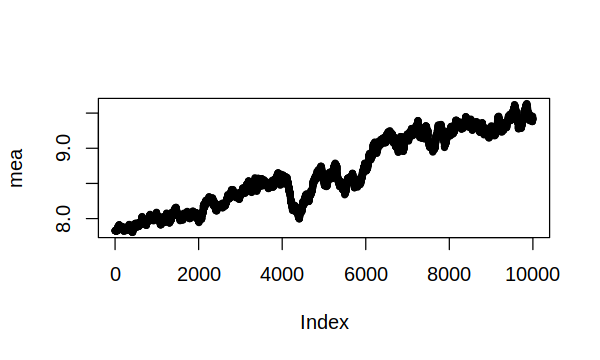

In [178]:
y <- metroCircle(1,100,10000,10,1)

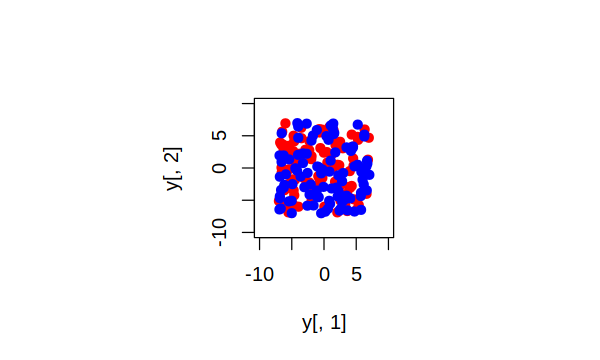

In [179]:
L <- 10
par(pty="s")
plot(y[,1],y[,2],col="red",xlim = c(-L, L),ylim = c(-L, L),pch=19)
points(y[,3],y[,4],col= "blue",pch=19)